In [1]:
import pandas as pd
import numpy as np
from dotenv import dotenv_values, find_dotenv
import datetime as dt
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import ListedColormap
import os
config = dotenv_values(find_dotenv())
path_rawdata = os.path.abspath(config["RAWDATA"]) + '\\'
path_cleandata = os.path.abspath(config["CLEANDATA"]) + '\\'
path_figures = os.path.abspath(config["FIGURES"]) + '\\'

# for plots
plt.rcParams.update({'font.size': 25})

In [2]:
# choose one date per decade for the troubleshooting plots (maybe just the fifth year, July 31 per decade since its the middle of the year ish)
plotdates = [dt.datetime(1965,7,31), dt.datetime(1975,7,31), dt.datetime(1985,7,31), dt.datetime(1995,7,31), dt.datetime(2005,7,31), dt.datetime(2015,7,31)]

# import monte carlo stuff
montecarlo_intermediates = pd.read_pickle(path_cleandata + 'montecarlogenerated\\intermediateprices.pkl')
montecarlo_sales = pd.read_pickle(path_cleandata + 'montecarlogenerated\\sales.pkl')
montecarlo_output = pd.read_pickle(path_cleandata + 'montecarlogenerated\\realoutput.pkl')
montecarlo_valueadded = pd.read_pickle(path_cleandata + 'montecarlogenerated\\valueaddedprices.pkl')
montecarlo_prices = pd.read_pickle(path_cleandata + 'montecarlogenerated\\prices.pkl')

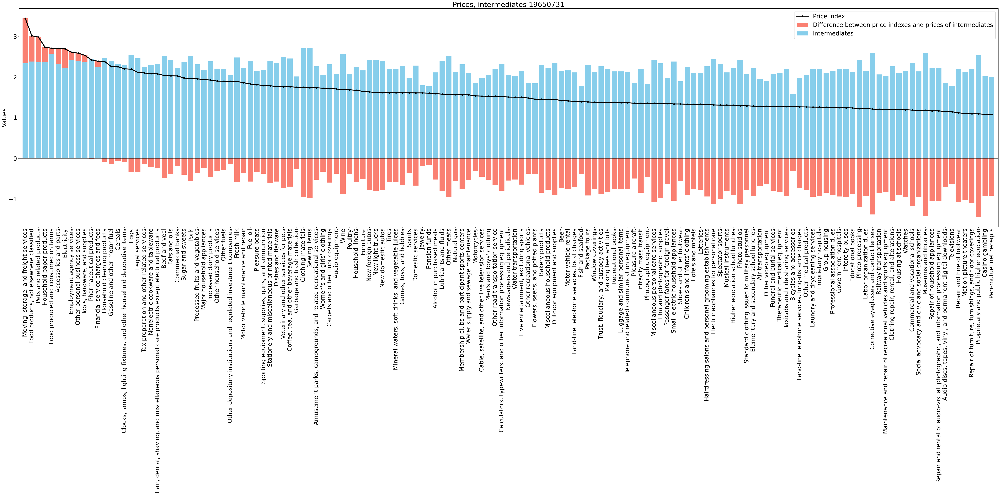

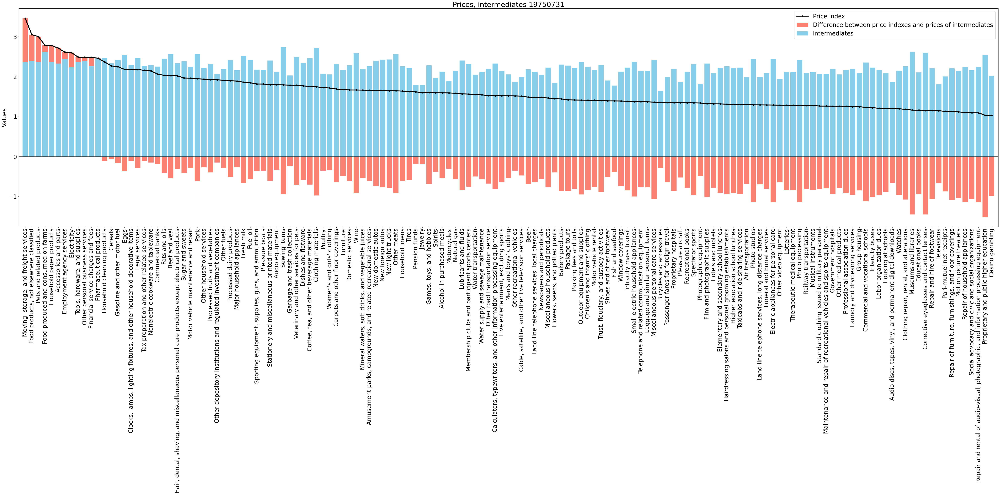

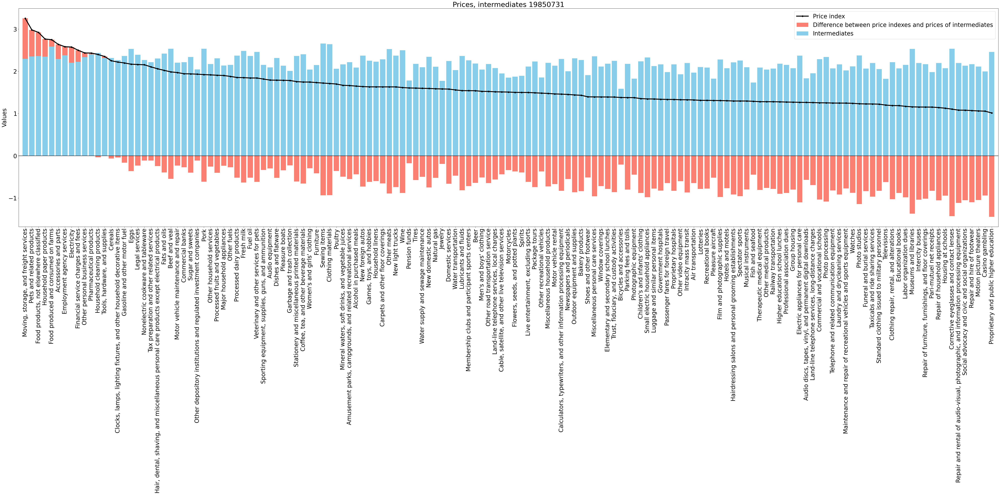

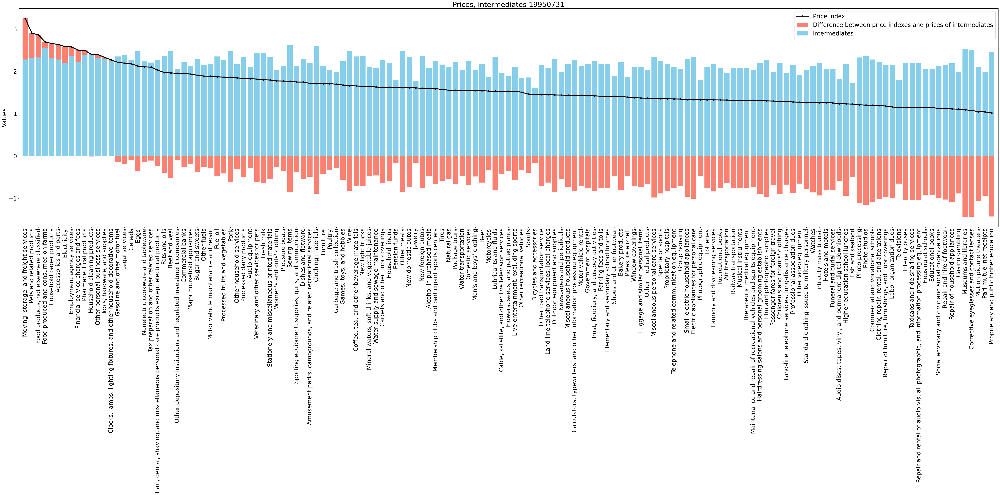

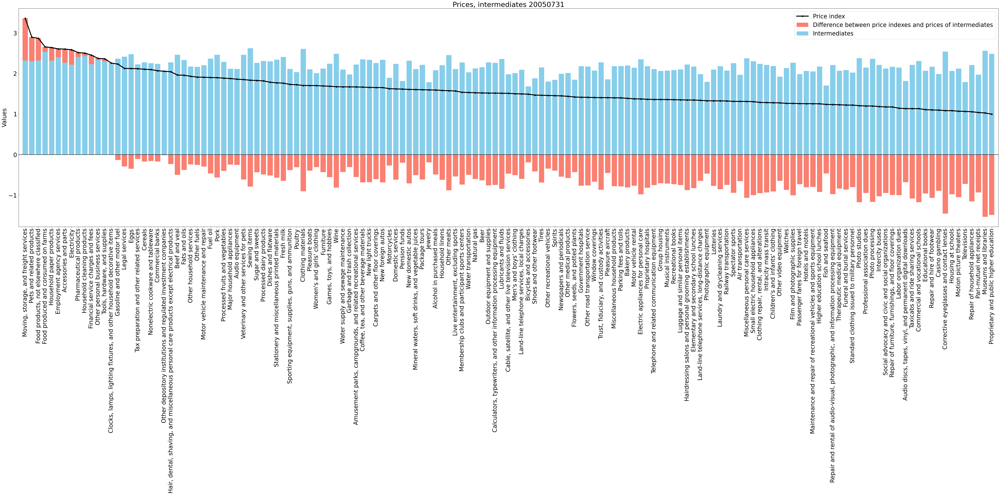

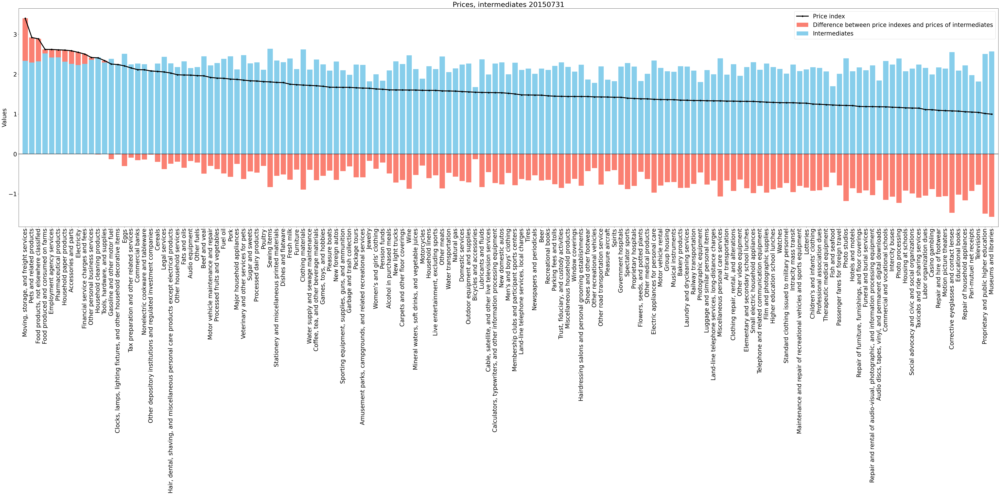

In [9]:
# intermediates vs prices (plot, non-log scale)
compare = montecarlo_prices[['date', 'product', 'intermediates', 'priceindex']].sort_values(['date', 'priceindex'], ascending=False)

for idx, date in enumerate(plotdates):
    toplot_date = compare[compare['date'] == date].set_index('product')
    products = toplot_date.index
    price = toplot_date['priceindex']
    intermediates_forplot = toplot_date['intermediates']
    diff = price - intermediates_forplot

    datestr = date.strftime("%Y/%m/%d").replace('/', '')

    # plots for price residuals

    # calculate heights for stacked bars
    positive_diff = np.where((diff >= 0) & (intermediates_forplot >= 0), diff, 0)
    positive_adjusted = np.where((diff >= 0) & (intermediates_forplot >= 0), intermediates_forplot, intermediates_forplot)
    negative_diff = np.where((diff < 0) & (intermediates_forplot < 0), diff, 0)
    negative_adjusted = np.where((diff < 0) & (intermediates_forplot < 0), intermediates_forplot, intermediates_forplot)

    # open figure
    fig, ax = plt.subplots(figsize=(60, 30))

    ax.axhline(y=0, color='black')

    # layering bars for the right display
    ax.bar(products, diff, color='salmon', label='Difference between price indexes and prices of intermediates')
    ax.bar(products, positive_adjusted, color='skyblue', label='Intermediates')
    ax.bar(products, positive_diff, color='salmon', bottom=positive_adjusted, label='_')
    ax.bar(products, negative_adjusted, color='skyblue', label='_')
    ax.bar(products, negative_diff, color='salmon', bottom=negative_adjusted, label='_')

    line, = ax.plot(products, price, linestyle='-', marker='o', color='black', linewidth=4, label='Price index')
    
    # set appearances
    ax.set_title('Prices, intermediates ' + datestr)
    ax.legend(loc='upper right')
    ax.set_ylabel('Values')
    ax.set_xticks(np.arange(len(products))) 
    ax.set_xticklabels(products, rotation=90)
    ax.set_xlim(-1, len(products))
    fig.tight_layout()

    plt.show()

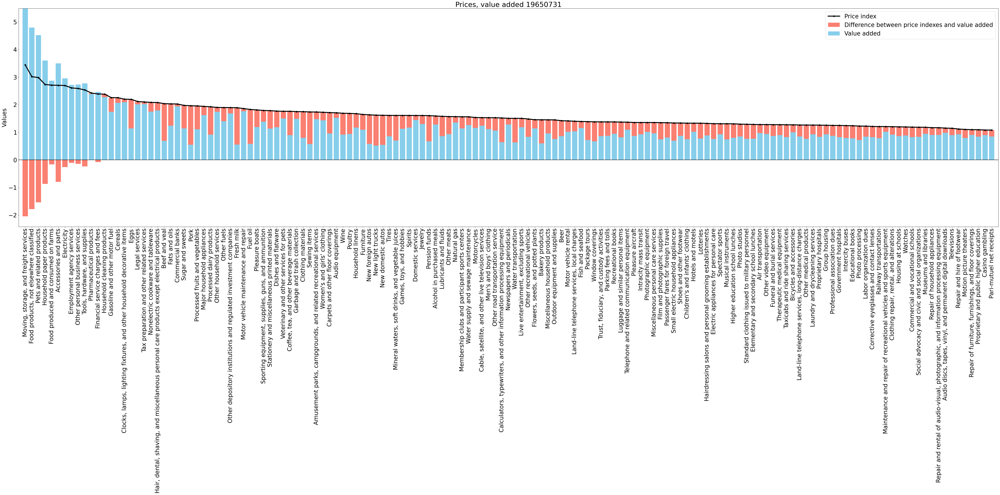

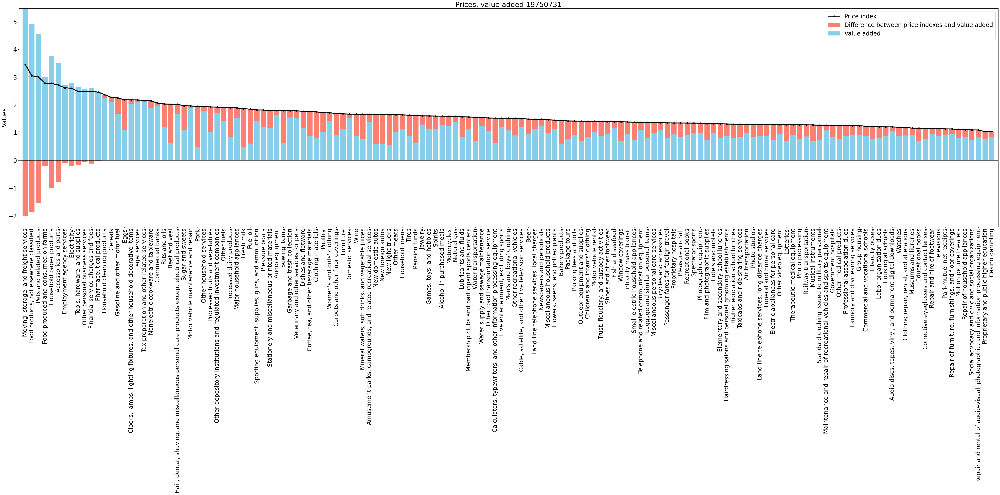

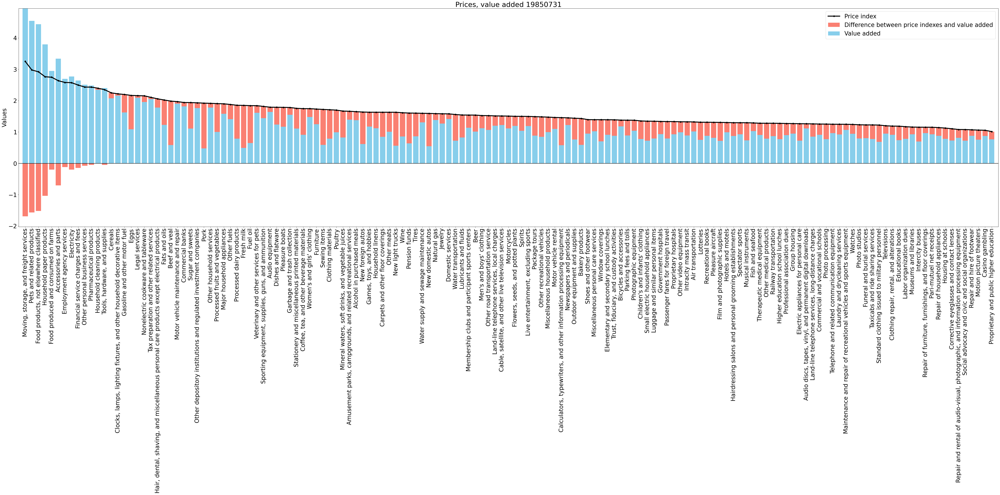

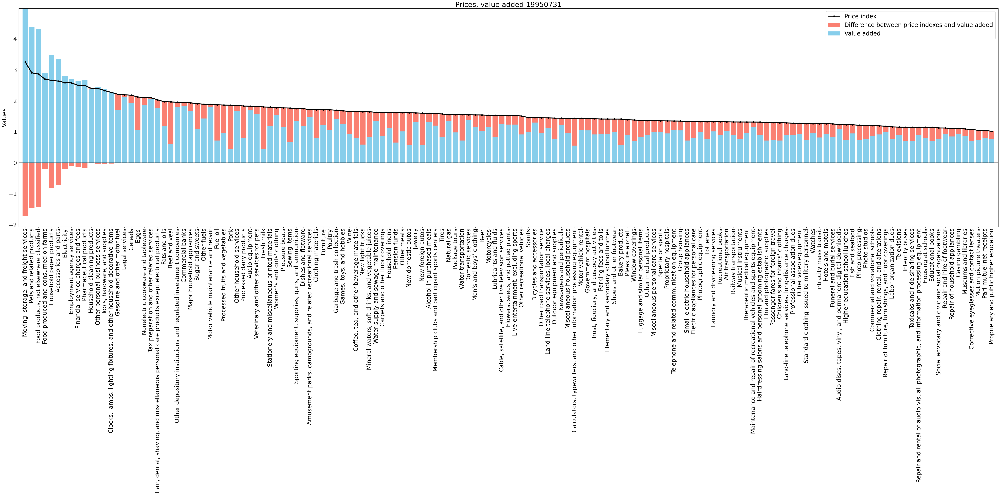

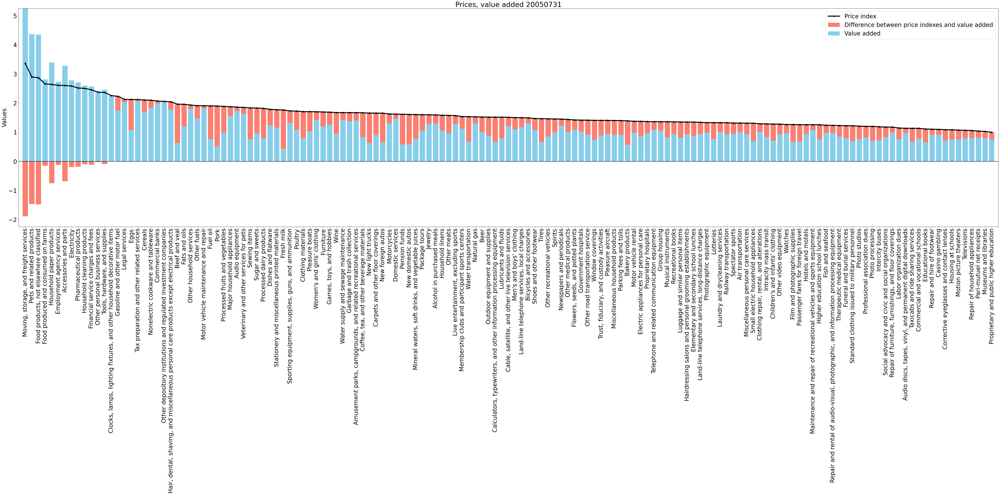

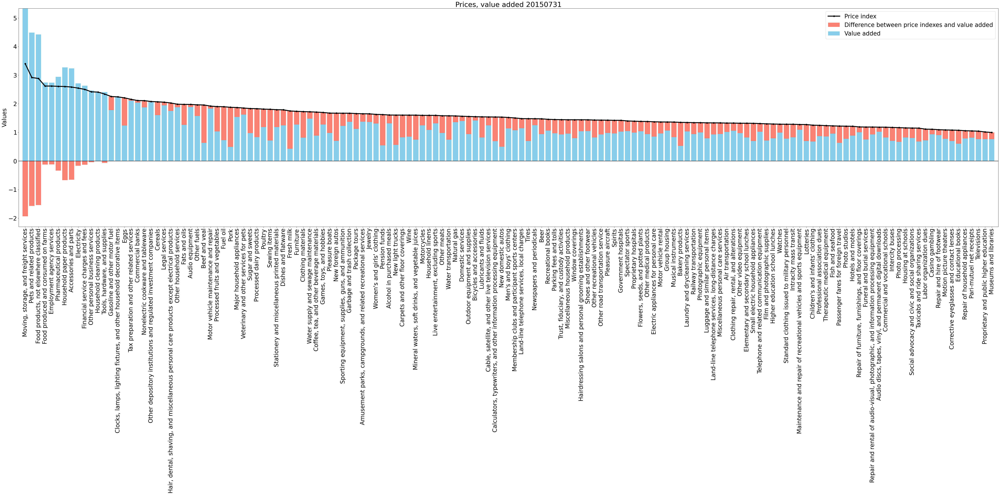

In [10]:
compare = montecarlo_prices[['date', 'product', 'value_added', 'priceindex']].sort_values(['date', 'priceindex'], ascending=False)

for idx, date in enumerate(plotdates):
    toplot_date = compare[compare['date'] == date].set_index('product')
    products = toplot_date.index
    price = toplot_date['priceindex']
    value_added_forplot = toplot_date['value_added']
    diff = price - value_added_forplot

    datestr = date.strftime("%Y/%m/%d").replace('/', '')

    # plots for price residuals

    # calculate heights for stacked bars
    positive_diff = np.where((diff >= 0) & (value_added_forplot >= 0), diff, 0)
    positive_adjusted = np.where((diff >= 0) & (value_added_forplot >= 0), value_added_forplot, value_added_forplot)
    negative_diff = np.where((diff < 0) & (value_added_forplot < 0), diff, 0)
    negative_adjusted = np.where((diff < 0) & (value_added_forplot < 0), value_added_forplot, value_added_forplot)

    # open figure
    fig, ax = plt.subplots(figsize=(60, 30))

    ax.axhline(y=0, color='black')

    # layering bars for the right display
    ax.bar(products, diff, color='salmon', label='Difference between price indexes and value added')
    ax.bar(products, positive_adjusted, color='skyblue', label='Value added')
    ax.bar(products, positive_diff, color='salmon', bottom=positive_adjusted, label='_')
    ax.bar(products, negative_adjusted, color='skyblue', label='_')
    ax.bar(products, negative_diff, color='salmon', bottom=negative_adjusted, label='_')

    line, = ax.plot(products, price, linestyle='-', marker='o', color='black', linewidth=4, label='Price index')
    
    # set appearances
    ax.set_title('Prices, value added ' + datestr)
    ax.legend(loc='upper right')
    ax.set_ylabel('Values')
    ax.set_xticks(np.arange(len(products))) 
    ax.set_xticklabels(products, rotation=90)
    ax.set_xlim(-1, len(products))
    fig.tight_layout()

    plt.show()